In the last notebook, we made a table called 'toronto_speed_data.csv', with speed, FFS, TTI and counts for each 5 minute timebin in January. Now let's aggregate those and visualize them.

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import shapely
import contextily as ctx
import os
import pylab as P
import matplotlib.animation
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [2]:
ctx.sources.ST_TONER_LITE

'http://tile.stamen.com/toner-lite/tileZ/tileX/tileY.png'

First thing is to define a helper function. We'll use this over and over to add the "basemap". Our roads will be coloured lines without context if we don't use a basemap.

In [2]:
def add_basemap(ax, zoom, url='http://tile.stamen.com/terrain/tileZ/tileX/tileY.png',
                alpha=1.0):
    xmin, xmax, ymin, ymax = ax.axis()
    basemap, extent = ctx.bounds2img(xmin, ymin, xmax, ymax, zoom=zoom, url=url)
    ax.imshow(basemap, extent=extent, interpolation='bilinear',
              alpha=alpha)
    ax.axis((xmin, xmax, ymin, ymax))

Let's map just the routes used and see where these roads we're studying actually are.

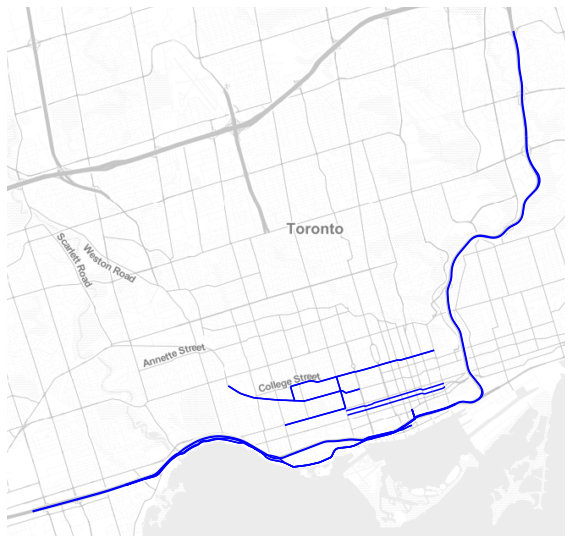

In [3]:
data_path = '/Users/jeffsalvail/documents/data/'
df_routes = gpd.read_file(data_path+'shapefile/bluetooth_routes_wgs84.shp')

output_path = '/Users/jeffsalvail/Dropbox/Python/geo/toronto/output/'


ax = df_routes.to_crs(epsg=3857).plot(figsize=(10, 10), edgecolor='b')
add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,
            alpha=0.5)
ax.set_axis_off()
#P.savefig(output_path+'routes_map.png')

Neat! One thing I noticed is at this scale, opposite direction roads are pretty much overlapping. I made this little snippet to separate such roads so we can see both ways on the map - very important if you want to know which directions are congested!

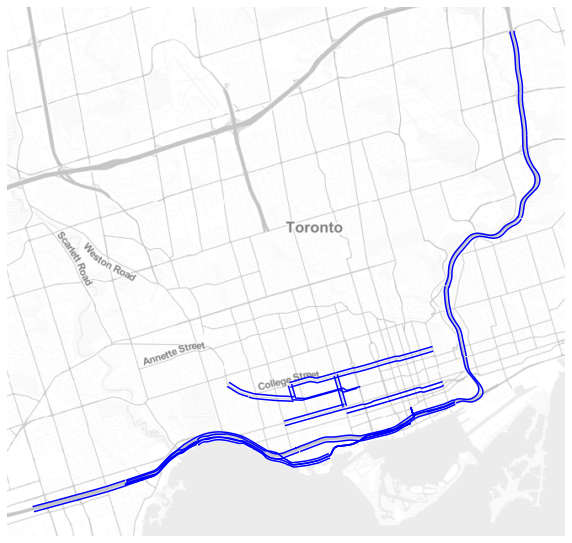

In [4]:
df_routes_modded = df_routes.copy()

for i,row_i in df_routes_modded.iterrows():
    resultId = row_i['resultId']
    nodes = resultId.split('_')
    
    other_way = '%s_%s'%(nodes[1],nodes[0])
    other_way_check = not df_routes_modded[df_routes_modded['resultId']==other_way].empty
    if other_way_check and nodes[0]<nodes[1]:
        j = df_routes_modded[df_routes_modded['resultId']==other_way].index[0]
        row_j = df_routes_modded.loc[j]
        centroid_i = row_i.geometry.centroid
        centroid_j = row_j.geometry.centroid
        d = centroid_i.distance(centroid_j)
        offset = 0.0007
        if d:
            
            center = shapely.geometry.LineString([centroid_i,centroid_j]).centroid
            
            unit_vec_i = np.array([centroid_i.x-center.x,centroid_i.y-center.y])/(d/2.)
            xoff_i,yoff_i = offset*unit_vec_i
            
            unit_vec_j = np.array([centroid_j.x-center.x,centroid_j.y-center.y])/(d/2.)
            xoff_j,yoff_j = offset*unit_vec_j
        else:
            coords_i = list(row_i.geometry.coords)
            a,b = coords_i[0],coords_i[1]
            dx, dy = b[0] - a[0], b[1] - a[1]
            perp_theta = np.arctan(-dx/dy)
            
            xoff_i,yoff_i = offset*np.cos(perp_theta),offset*np.sin(perp_theta)
            xoff_j,yoff_j = offset*np.cos(perp_theta+np.pi),offset*np.sin(perp_theta+np.pi)
            
            
        df_routes_modded.loc[i,'geometry'] = shapely.affinity.translate(df_routes_modded.loc[i,'geometry'],xoff=xoff_i, yoff=yoff_i, zoff=0.0)
        df_routes_modded.loc[j,'geometry'] = shapely.affinity.translate(df_routes_modded.loc[j,'geometry'],xoff=xoff_j, yoff=yoff_j, zoff=0.0)
        
df_routes_modded = df_routes_modded.set_index('resultId')
        
ax = df_routes_modded.to_crs(epsg=3857).plot(figsize=(10, 10), edgecolor='b')
add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,
            alpha=0.5)
ax.set_axis_off()        

That's  little better. Still messy in some spots but it'll do for now. We'll proceed with df_routes_modded.

Now let's load in the table we made in the previous notebook.

In [5]:
df_speed_data = pd.read_csv(data_path+'toronto_speed_data.csv',
                             parse_dates = [1,]).reset_index(drop=True).set_index('resultId')
df_speed_data[:10]

,updated,median_speed_kph,FFS,TTI,count
resultId,,,,,
AC1_AC2,2017-01-01 00:05:00,15.209756,22.200678,1.459634,4.0
AC1_AC2,2017-01-01 00:10:00,12.726531,22.200678,1.744441,5.0
AC1_AC2,2017-01-01 00:15:00,12.612135,22.200678,1.760263,3.0
AC1_AC2,2017-01-01 00:20:00,11.269880,22.200678,1.969913,3.0
AC1_AC2,2017-01-01 00:25:00,16.955891,22.200678,1.309319,3.0
AC1_AC2,2017-01-01 00:30:00,14.101508,22.200678,1.574348,7.0
AC1_AC2,2017-01-01 00:35:00,13.688780,22.200678,1.621816,3.0
AC1_AC2,2017-01-01 00:40:00,14.769474,22.200678,1.503146,6.0
AC1_AC2,2017-01-01 00:50:00,15.046649,22.200678,1.475457,3.0


Let's plot the static numbers first: FFS, and total counts.

Because these are link-constant, we don't need to work with this huge table. Let's pivot it down to get the average FFS for each link (as a link constant, the average is just the value), and the total number of counts on each link, to get a sense of the traffic volume and/or sample size.

(the .dropna() drops rows that contain NaNs - no observations were made)

In [6]:
df_link_properties = pd.pivot_table(df_speed_data,
                                   index='resultId',
                                   values=['FFS','count'],
                                   aggfunc={'FFS':np.nanmean,
                                             'count':np.sum}
                                  ).dropna()
df_link_properties[:10]

,FFS,count
resultId,,
AC1_AC2,22.200678,32911.0
AC1_AD3,21.272678,18592.0
AC2_AC1,22.780166,26477.0
AD1_AD2,33.535992,31053.0
AD2_AD1,33.676336,35707.0
AD2_AD3,25.353012,23071.0
AD3_AC1,23.327818,18337.0
AD3_AD2,25.935554,22949.0
AD3_AD4,23.449969,27263.0


Now we'll join it to our shapefile and plot!

In [7]:
df_link_properties = df_link_properties.join(df_routes_modded).drop(['normalDriv','length_m'],axis=1)
df_link_properties[:10]

,FFS,count,geometry
resultId,,,
AC1_AC2,22.200678,32911.0,LINESTRING (-79.42623901403661 43.652919925582...
AC1_AD3,21.272678,18592.0,LINESTRING (-79.42575081114157 43.653851907641...
AC2_AC1,22.780166,26477.0,LINESTRING (-79.42654039840235 43.654287100576...
AD1_AD2,33.535992,31053.0,LINESTRING (-79.45132995163281 43.654382500922...
AD2_AD1,33.676336,35707.0,LINESTRING (-79.45208912576344 43.653206212420...
AD2_AD3,25.353012,23071.0,LINESTRING (-79.44299865879876 43.651398135320...
AD3_AC1,23.327818,18337.0,LINESTRING (-79.42705633433317 43.653346329560...
AD3_AD2,25.935554,22949.0,LINESTRING (-79.44329986872251 43.650030921883...
AD3_AD4,23.449969,27263.0,LINESTRING (-79.42410086489552 43.649696049683...


Text(0.5, 1, 'Free-flow speed from BT observations')

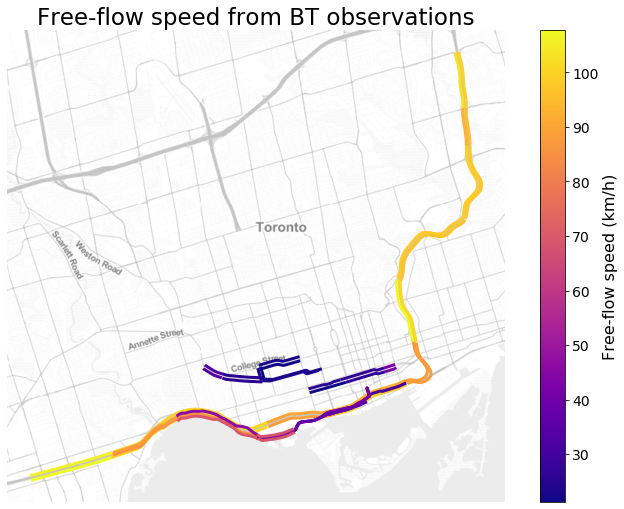

In [8]:
crs = {'init': 'epsg:4326'}
gdf_link_properties = gpd.GeoDataFrame(df_link_properties, crs=crs)

fig=P.figure(figsize=(10,10))
ax=fig.add_subplot()

# this code snippet is annoying, not sure why the usual approach doesn't work
# I should turn it into a helper function
if 1:
    # Create colorbar as a legend
    sm = P.cm.ScalarMappable(cmap='plasma',
                             norm=P.Normalize(vmin=gdf_link_properties['FFS'].min(),
                                              vmax=gdf_link_properties['FFS'].max()))
    # empty array for the data range
    sm._A = []
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.5)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.ax.tick_params(labelsize=14)

gdf_link_properties.to_crs(epsg=3857).plot(ax=ax,
                                           column='FFS',
                                           linewidth=3,
                                           cmap='plasma',
                                           legend=False,
                                               )

add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
ax.set_axis_off()
cbar.set_label('Free-flow speed (km/h)',fontsize=16)
ax.set_title('Free-flow speed from BT observations',fontsize=23)

#P.savefig(output_path+'FFS.png')

Text(0.5, 1, 'Number of BT observations')

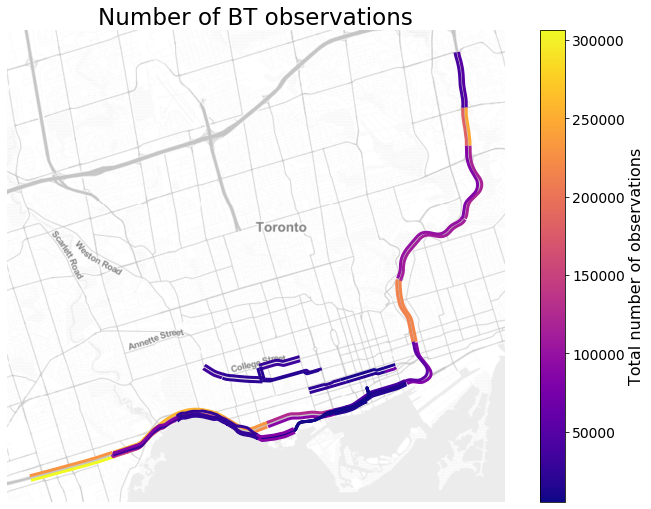

In [9]:
crs = {'init': 'epsg:4326'}
gdf_link_properties = gpd.GeoDataFrame(df_link_properties, crs=crs)

fig=P.figure(figsize=(10,10))
ax=fig.add_subplot()

# this code snippet is annoying, not sure why the usual approach doesn't work
# I should turn it into a helper function
if 1:
    # Create colorbar as a legend
    sm = P.cm.ScalarMappable(cmap='plasma',
                             norm=P.Normalize(vmin=gdf_link_properties['count'].min(),
                                              vmax=gdf_link_properties['count'].max()))
    # empty array for the data range
    sm._A = []
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.5)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.ax.tick_params(labelsize=14)

gdf_link_properties.to_crs(epsg=3857).plot(ax=ax,
                                           column='count',
                                           linewidth=3,
                                           cmap='plasma',
                                           legend=False,
                                               )

add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
ax.set_axis_off()
cbar.set_label('Total number of observations',fontsize=16)
ax.set_title('Number of BT observations',fontsize=23);

#P.savefig(output_path+'total_counts.png')

Combine the above info to a more intuitive map: line thickness represents total counts, colour represents average speed.

,FFS,count,geometry,count_rank
resultId,,,,
AC1_AC2,22.200678,32911.0,LINESTRING (-79.42623901403661 43.652919925582...,1
AC1_AD3,21.272678,18592.0,LINESTRING (-79.42575081114157 43.653851907641...,1
AC2_AC1,22.780166,26477.0,LINESTRING (-79.42654039840235 43.654287100576...,1
AD1_AD2,33.535992,31053.0,LINESTRING (-79.45132995163281 43.654382500922...,1
AD2_AD1,33.676336,35707.0,LINESTRING (-79.45208912576344 43.653206212420...,1
AD2_AD3,25.353012,23071.0,LINESTRING (-79.44299865879876 43.651398135320...,1
AD3_AC1,23.327818,18337.0,LINESTRING (-79.42705633433317 43.653346329560...,1
AD3_AD2,25.935554,22949.0,LINESTRING (-79.44329986872251 43.650030921883...,1
AD3_AD4,23.449969,27263.0,LINESTRING (-79.42410086489552 43.649696049683...,1


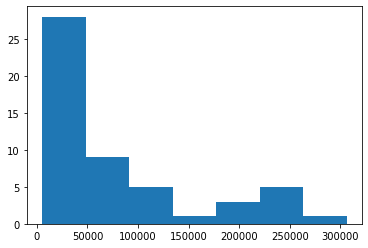

In [12]:
def count_rank(df,N=7):
    hist_y,hist_bins,hist = P.hist(df['count'],bins=N)
    running_rank = N
    for i in range(0,N):
        running_rank -= (df['count'] < hist_bins[i]).astype(int)
    return running_rank,hist_bins

df_link_properties['count_rank'],hist_bins = count_rank(df_link_properties)
df_link_properties[:10]

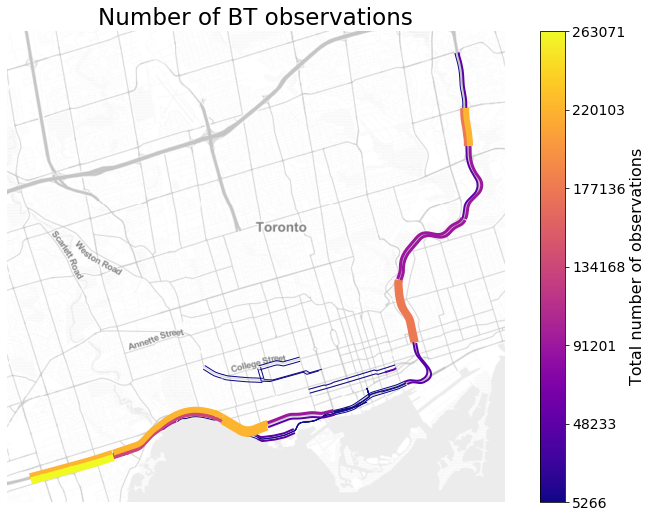

In [14]:
%matplotlib inline

crs = {'init': 'epsg:4326'}
gdf_link_properties = gpd.GeoDataFrame(df_link_properties, crs=crs)

fig=P.figure(figsize=(10,10))
ax=fig.add_subplot()

# this code snippet is annoying, not sure why the usual approach doesn't work
# I should turn it into a helper function
if 1:
    # Create colorbar as a legend
    sm = P.cm.ScalarMappable(cmap='plasma',
                             norm=P.Normalize(vmin=gdf_link_properties['count_rank'].min(),
                                              vmax=gdf_link_properties['count_rank'].max()))
    # empty array for the data range
    sm._A = []
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.5)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.ax.tick_params(labelsize=14)
    
for rank,df_rank in gdf_link_properties.groupby(by='count_rank'):
    
    df_rank.to_crs(epsg=3857).plot(ax=ax,
                                   linewidth=rank,
                                   column='count_rank',
                                   vmin=gdf_link_properties['count_rank'].min(),
                                   vmax=gdf_link_properties['count_rank'].max(),
                                   cmap='plasma',
                                   legend=False,
                                       )

add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
ax.set_axis_off()

# need to add a legend with the linewidths!

cbar.set_ticks(cbar.get_ticks())
cbar.set_ticklabels(hist_bins.astype(int))
cbar.set_label('Total number of observations',fontsize=16)
ax.set_title('Number of BT observations',fontsize=23);

#P.savefig(output_path+'counts_thickness_and_colour.png')

Now let's get to the good stuff. Let's get the average hourly TTI. For each hour, we want the average TTI over the whole month. This will take a loop.

TTI   count  count_rank
  resultId                              
0 AC1_AC2   1.164807  1025.0           1
  AC1_AD3   1.527026   691.0           1
  AC2_AC1   1.234578   922.0           1
  AC2_AC3        NaN     0.0           1
  AC2_AQ2        NaN     0.0           1
  AC3_AC2        NaN     0.0           1
  AC3_AC4        NaN     0.0           1
  AC4_AC3        NaN     0.0           1
  AD1_AD2   1.198948   760.0           1
  AD2_AD1   1.135861  1020.0           1

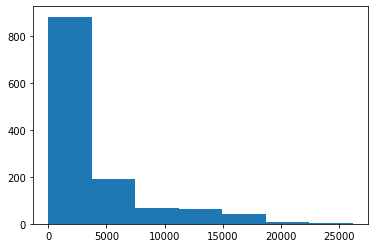

In [16]:
def groupby_hour(df):
    df = df.reset_index().set_index('updated')
    by_hour=[]
    hours = range(0,24)
    for hour in hours:
        
        sliced = df.between_time('%02d:00'%(hour),'%02d:00'%((hour+1)%24))
        df_hour = pd.pivot_table(sliced,
                                 index='resultId',
                                 values=['TTI','count'],
                                 aggfunc={'TTI':np.nanmean,
                                          'count':np.sum}
                                )
        by_hour.append(df_hour)
    return pd.concat(by_hour,keys=hours)

avg_TTI_hour = groupby_hour(df_speed_data.reset_index().set_index(['updated','resultId']))
avg_TTI_hour['count_rank'],hist_bins = count_rank(avg_TTI_hour)

avg_TTI_hour[:10]



The result of the above is a simple df with TTI as the values, and two levels of indices. One for the hour, (from 0 to 23) and one for the 'resultId' (identifies the link).

Let's join to our shapefile and plot!

In [17]:
crs = {'init': 'epsg:4326'}
gdf_avg_TTI = gpd.GeoDataFrame(avg_TTI_hour.copy().join(df_routes_modded), crs=crs).drop(['normalDriv','length_m'],axis=1)
gdf_avg_TTI[:10]

TTI   count  count_rank  \
  resultId                                 
0 AC1_AC2   1.164807  1025.0           1   
  AC1_AD3   1.527026   691.0           1   
  AC2_AC1   1.234578   922.0           1   
  AC2_AC3        NaN     0.0           1   
  AC2_AQ2        NaN     0.0           1   
  AC3_AC2        NaN     0.0           1   
  AC3_AC4        NaN     0.0           1   
  AC4_AC3        NaN     0.0           1   
  AD1_AD2   1.198948   760.0           1   
  AD2_AD1   1.135861  1020.0           1   

                                                     geometry  
  resultId                                                     
0 AC1_AC2   LINESTRING (-79.42623901403661 43.652919925582...  
  AC1_AD3   LINESTRING (-79.42575081114157 43.653851907641...  
  AC2_AC1   LINESTRING (-79.42654039840235 43.654287100576...  
  AC2_AC3   LINESTRING (-79.40758551828054 43.655795578456...  
  AC2_AQ2   LINESTRING (-79.40335788902054 43.647441805803...  
  AC3_AC2   LINESTRING (-79.40785939893848 43.657168527612...  
  AC3_AC4   LINESTRING (-79.39034630849471 43.659174721556...  
  AC4_AC3   LINESTRING (-79.39063895013771 43.660543794552...  
  AD1_AD2   LINESTRING (-79.45132995163281 43.654382500922...  
  AD2_AD1   LINESTRING (-79.45208912576344 43.653206212420...

/Users/jeffsalvail/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:479: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/Users/jeffsalvail/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


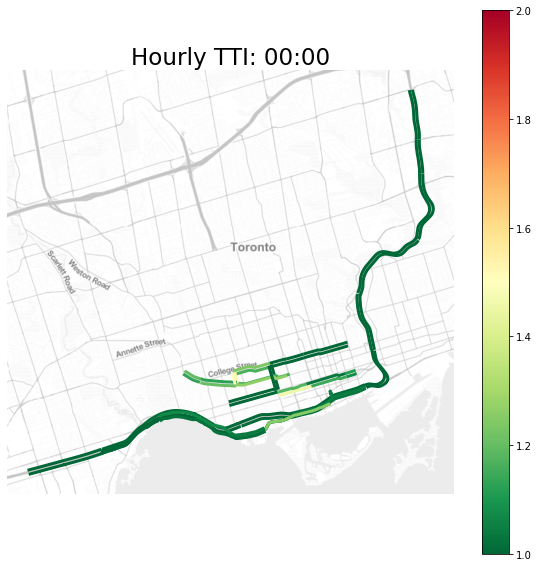

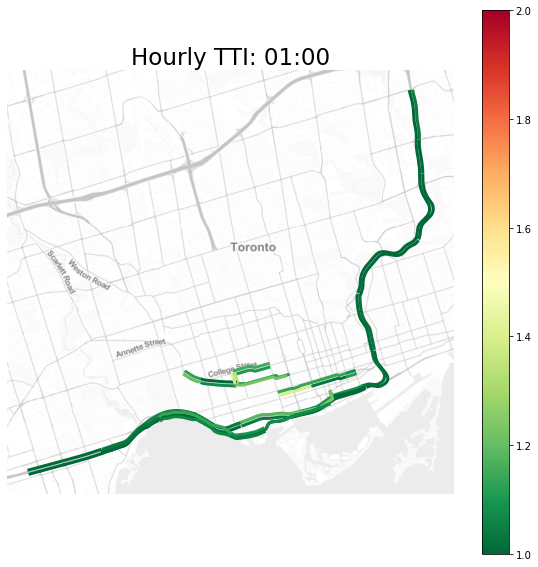

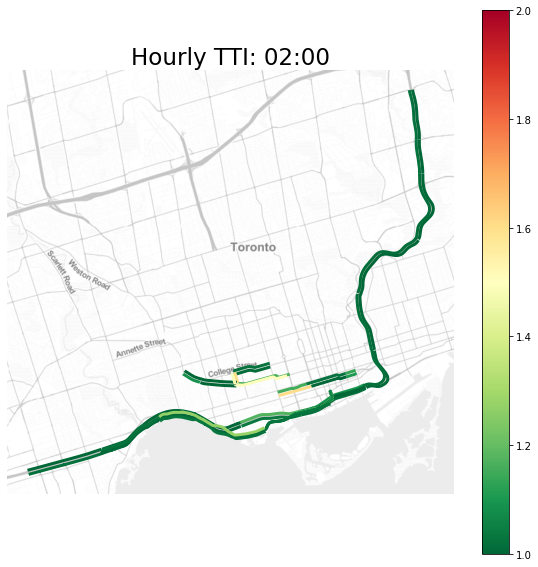

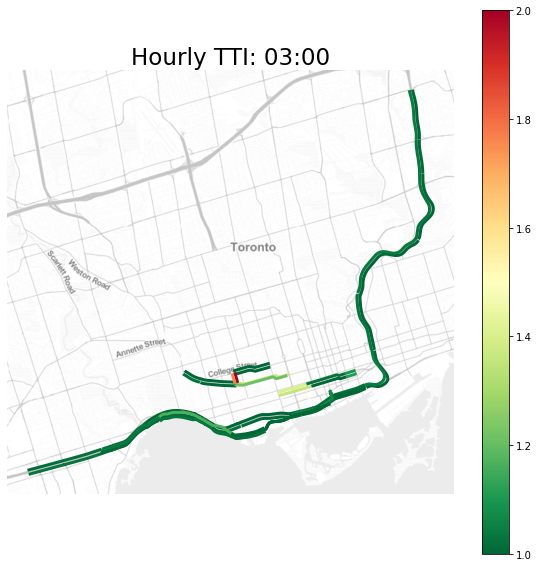

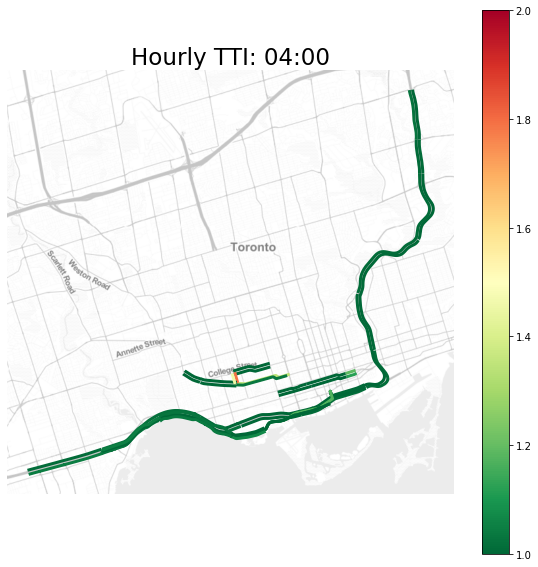

...

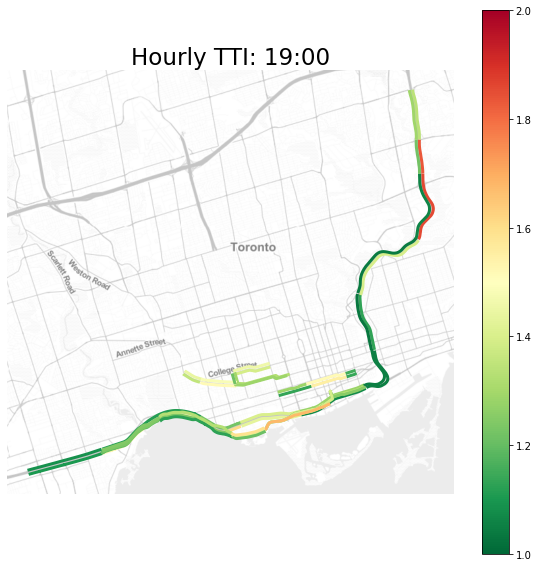

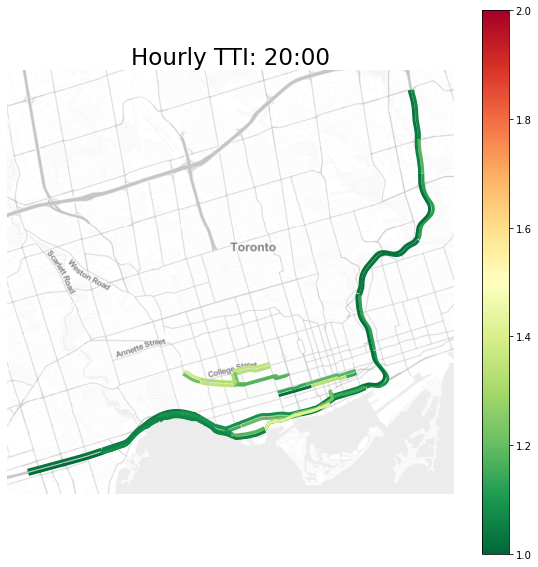

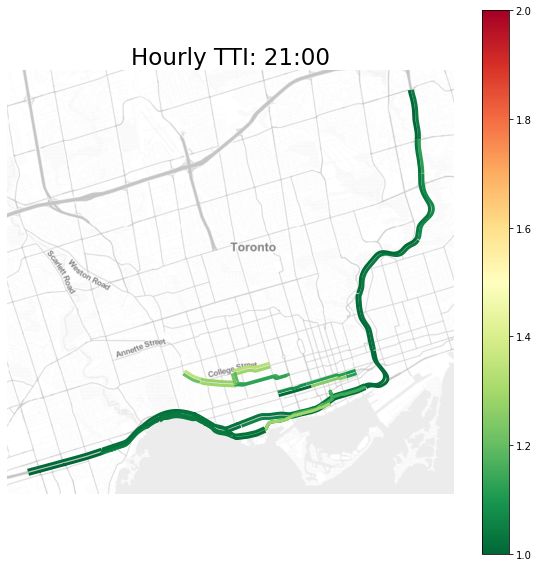

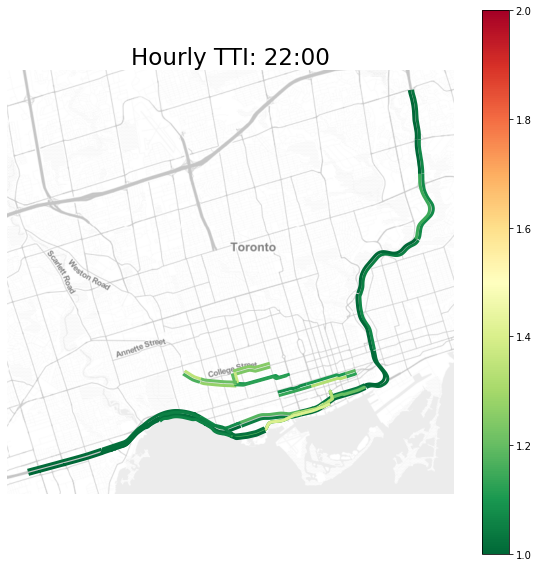

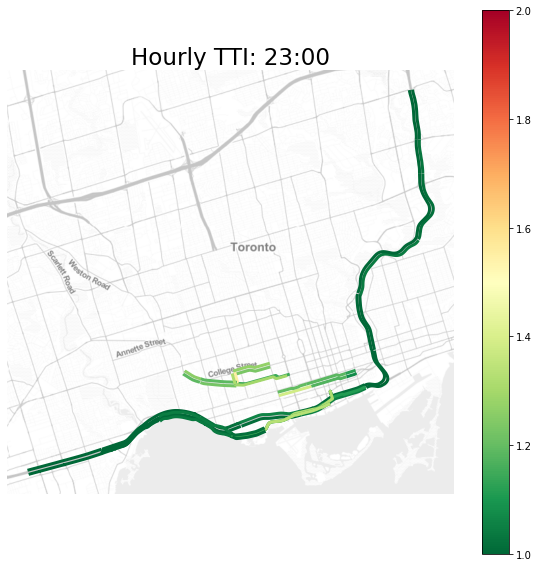

In [18]:
%matplotlib inline


for epoch in range(0,24):    
    fig=P.figure(figsize=(10,10))
    ax=fig.add_subplot(111)
    
    ax.set_title('Hourly TTI: %02d:00'%(epoch),fontsize=23)
    ax.set_axis_off()
    
    gdf_avg_TTI_epoch = gdf_avg_TTI.loc[epoch,:].copy()
    gdf_avg_TTI_epoch.to_crs(epsg=3857).plot(ax=ax,
                                             column='TTI',
                                             cmap='RdYlGn_r',
                                             vmin=1.,
                                             vmax=2.,
                                             linewidth=3,
                                             legend=True,
                                           )
    add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5);
    #P.savefig('output/hourly_TTI/hourly_TTI_%02d.png'%(epoch))
    

<IPython.core.display.Javascript object>


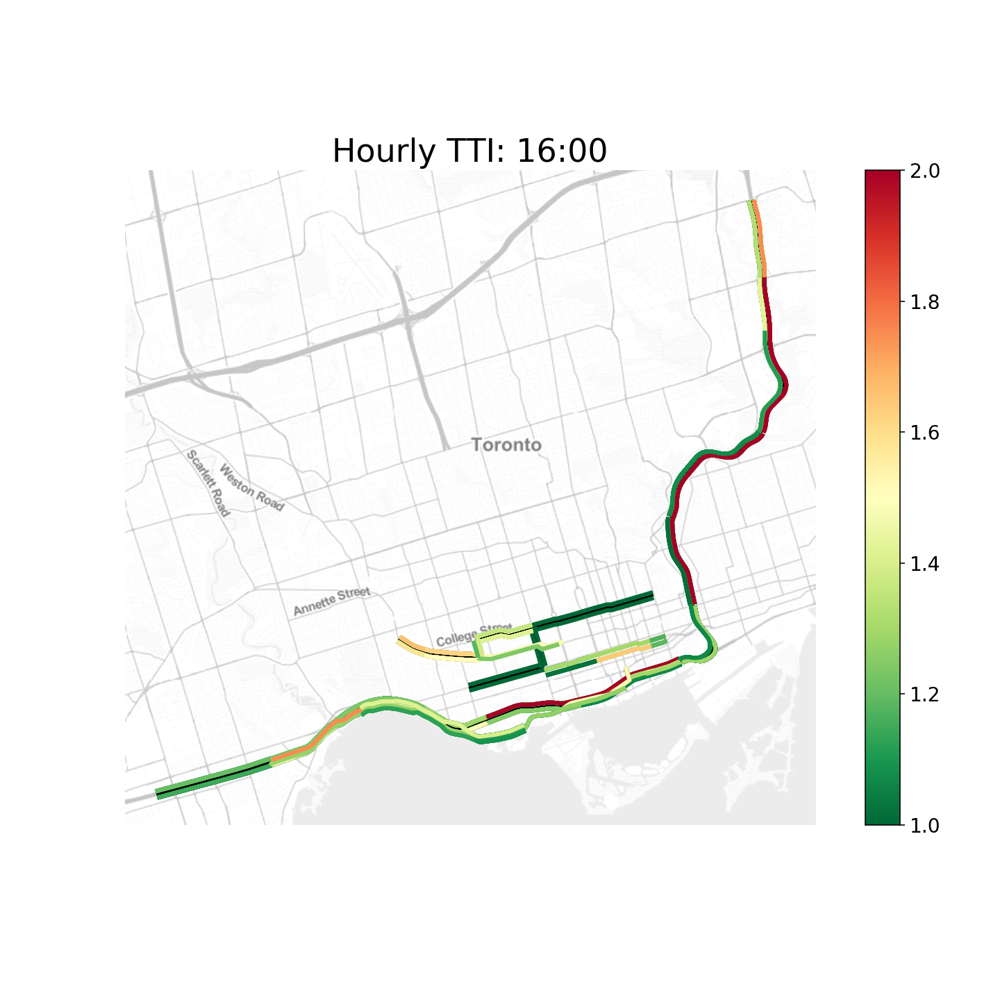

In [33]:
# animation from https://stackoverflow.com/questions/35532498/animation-in-ipython-notebook/46878531#46878531
# and fix geopandas cbar issue: from https://stackoverflow.com/questions/55107411/how-to-add-a-colorbar-to-geopandas-plot-with-matplotlib-animation


# for some reason this cell has to be run a few times in a row. Not sure why... something with the blitting I think

%matplotlib notebook

fig=P.figure(figsize=(10,10))
ax=fig.add_subplot(111)
ax.set_axis_off()

def init():
    ax.clear()
    ax.set_title('Hourly TTI:',fontsize=23)
    
    # Create colorbar as a legend
    sm = P.cm.ScalarMappable(cmap='RdYlGn_r', norm=P.Normalize(vmin=1., vmax=2.))
    # empty array for the data range
    sm._A = []
    # add the colorbar to the figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.5)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.ax.tick_params(labelsize=14)
    
    df_routes.to_crs(epsg=3857).plot(ax=ax,edgecolor='k')
    add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
    ax.set_axis_off()

def animate(epoch):
    ax.set_title('Hourly TTI: %02d:00'%(epoch),fontsize=23)
    gdf_avg_TTI_epoch = gdf_avg_TTI.loc[epoch,:].copy()
    gdf_avg_TTI_epoch.to_crs(epsg=3857).plot(ax=ax,
                                             column='TTI',
                                             cmap='RdYlGn_r',
                                             vmin=1.,
                                             vmax=2.,
                                             linewidth=3.,
                                             legend=False,
                                            )
    ax.set_axis_off()
    


epochs=np.arange(0,24)
ani = matplotlib.animation.FuncAnimation(fig,
                                         animate,
                                         epochs,
                                         init_func=init,
                                         blit=False
                                        )

P.show()


<IPython.core.display.Javascript object>


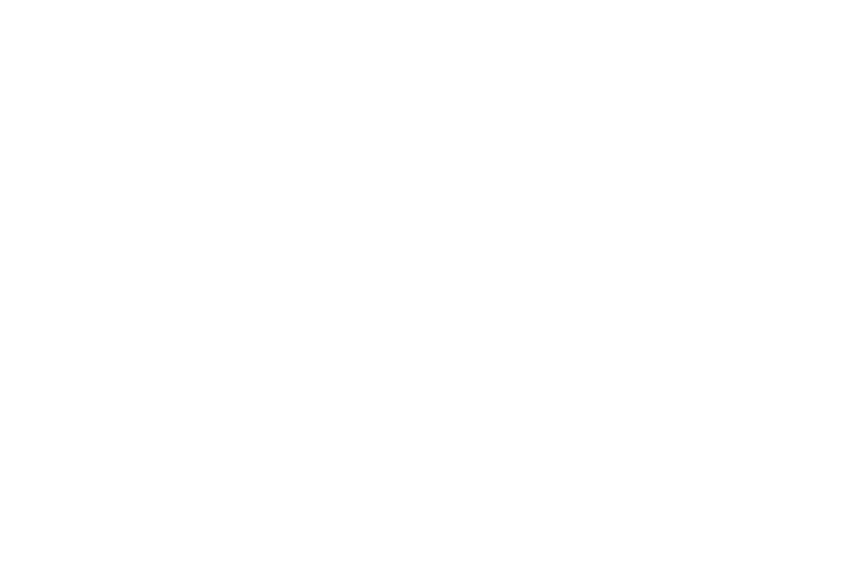

/Users/jeffsalvail/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:479: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


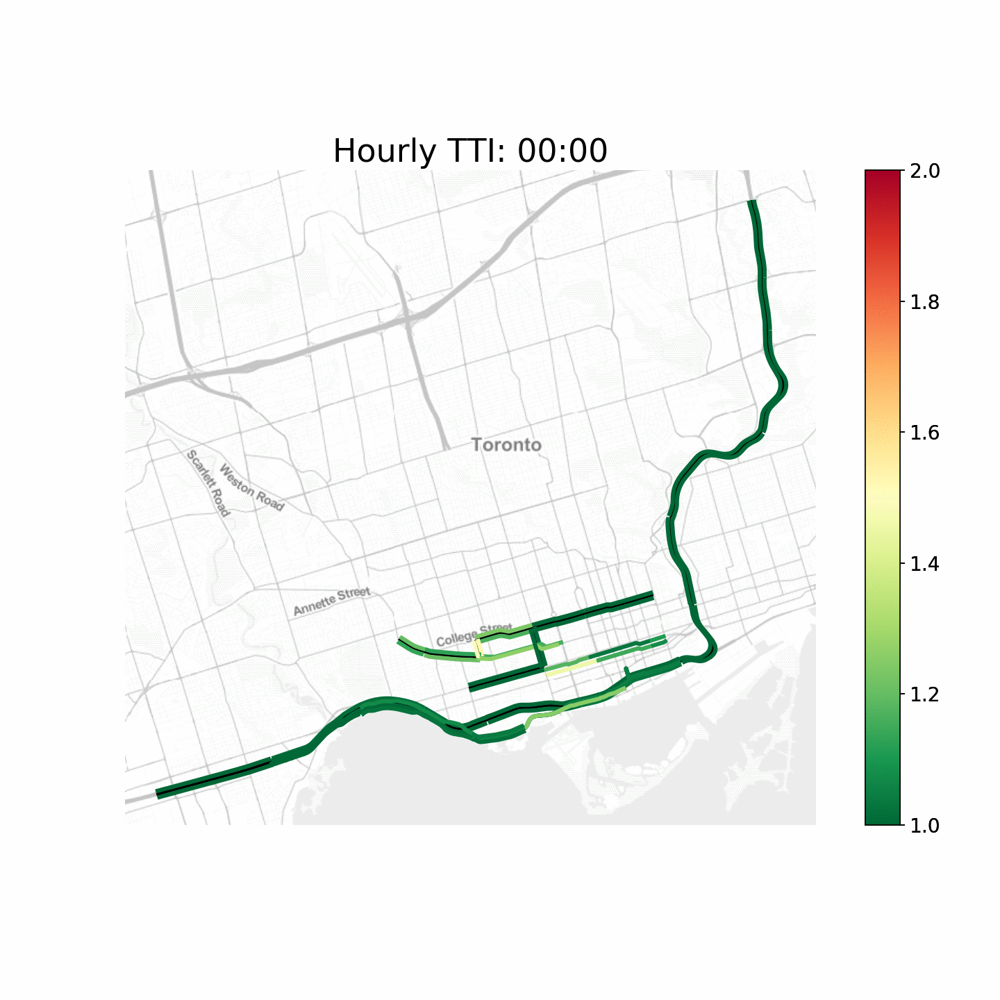

In [34]:
#http://louistiao.me/posts/notebooks/save-matplotlib-animations-as-gifs/
from IPython.display import HTML, Image
ani.save(output_path+'TTI_animation.gif', writer='imagemagick', fps=1)
Image(filename=output_path+'TTI_animation.gif')

<IPython.core.display.Javascript object>


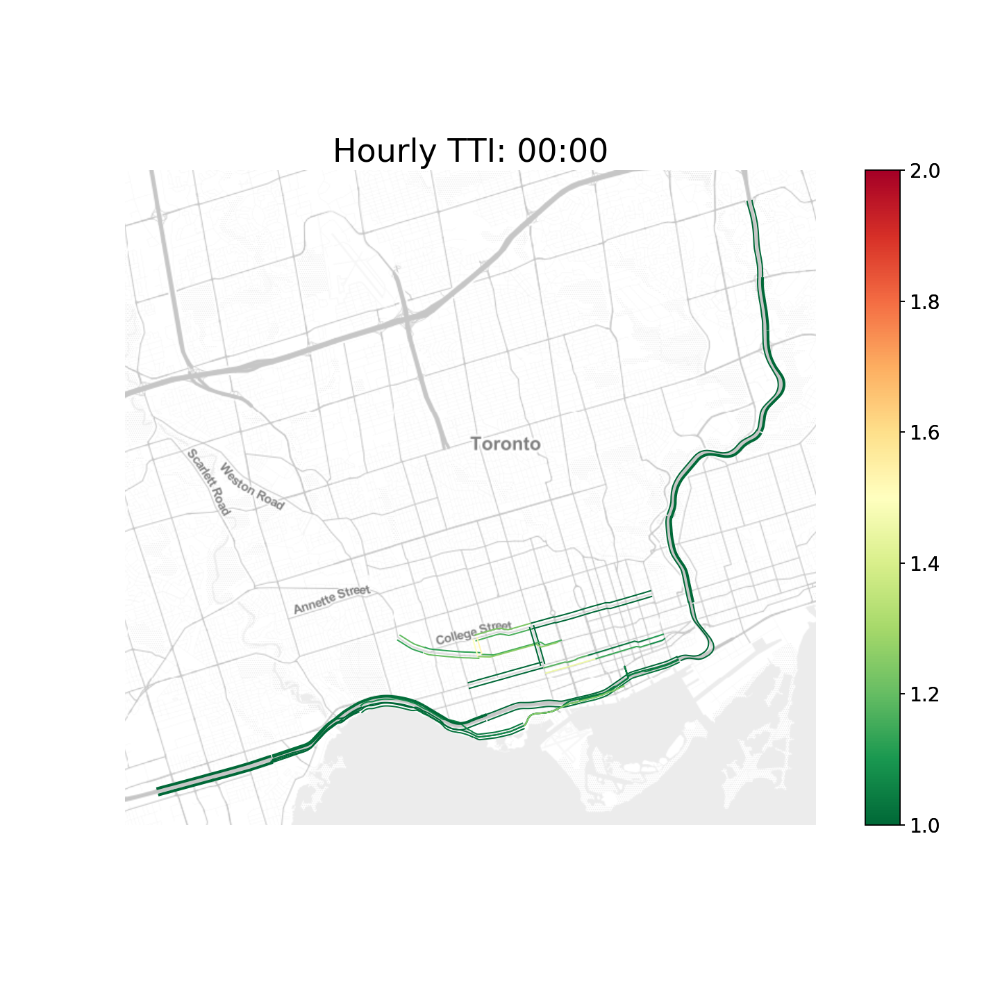

In [30]:
# animation from https://stackoverflow.com/questions/35532498/animation-in-ipython-notebook/46878531#46878531
# and fix geopandas cbar issue: from https://stackoverflow.com/questions/55107411/how-to-add-a-colorbar-to-geopandas-plot-with-matplotlib-animation


# for some reason this cell has to be run a few times in a row. Not sure why... something with the blitting I think

%matplotlib notebook

fig=P.figure(figsize=(10,10))
ax=fig.add_subplot(111)
ax.set_axis_off()

def init():
    ax.clear()
    ax.set_title('Hourly TTI:',fontsize=23)
    
    # Create colorbar as a legend
    sm = P.cm.ScalarMappable(cmap='RdYlGn_r', norm=P.Normalize(vmin=1., vmax=2.))
    # empty array for the data range
    sm._A = []
    # add the colorbar to the figure
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.5)
    cbar = fig.colorbar(sm, cax=cax)
    cbar.ax.tick_params(labelsize=14)
    
    df_routes.to_crs(epsg=3857).plot(ax=ax,edgecolor='k')
    add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
    ax.set_axis_off()

def animate(epoch):
    ax.clear()
    ax.set_title('Hourly TTI: %02d:00'%(epoch),fontsize=23)
    gdf_avg_TTI_epoch = gdf_avg_TTI.loc[epoch,:].copy()
    
    for rank,df_rank in gdf_avg_TTI_epoch.groupby(by='count_rank'):
        df_rank.to_crs(epsg=3857).plot(ax=ax,
                                       linewidth=rank,
                                       column='TTI',
                                       vmin=1.0,
                                       vmax=2.0,
                                       cmap='RdYlGn_r',
                                       legend=False,
                                           )
        
    add_basemap(ax, zoom=12,url=ctx.sources.ST_TONER_LITE,alpha=0.5)
    ax.set_axis_off()
    


epochs=np.arange(0,24)
ani = matplotlib.animation.FuncAnimation(fig,
                                         animate,
                                         epochs,
                                         init_func=init,
                                         blit=False
                                        )

P.show()


<IPython.core.display.Javascript object>


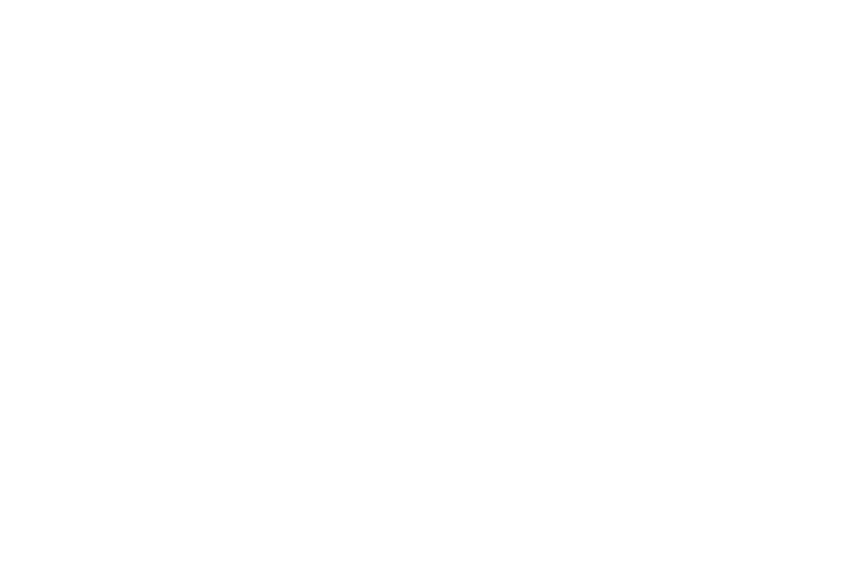

/Users/jeffsalvail/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:479: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


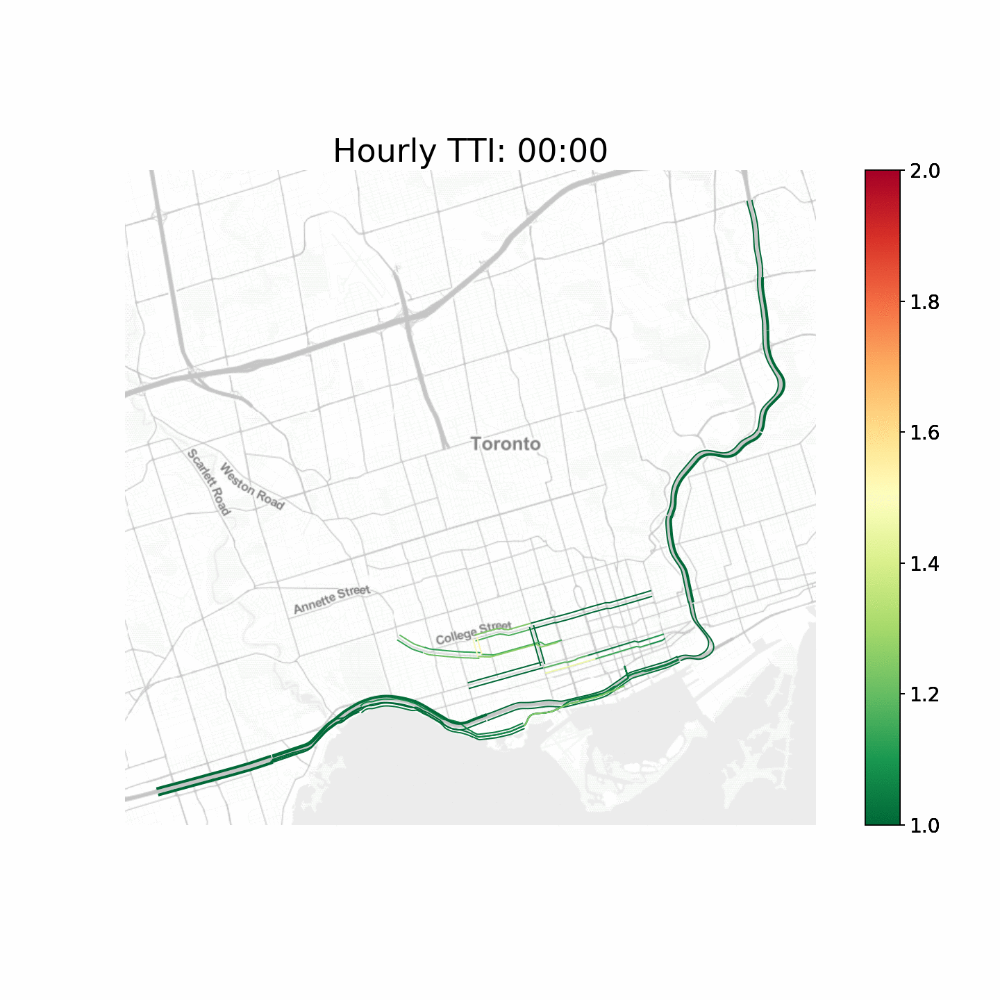

In [32]:
#http://louistiao.me/posts/notebooks/save-matplotlib-animations-as-gifs/
from IPython.display import HTML, Image
ani.save(output_path+'TTI_and_counts.gif', writer='imagemagick', fps=1)
Image(filename=output_path+'TTI_and_counts.gif')

In [ ]:



#### half hour epoch
epoch = 33
timea,timeb=half_hour_epoch_to_time(epoch),half_hour_epoch_to_time(epoch+1)

gdf_avg_TTI.between_time(timea,timeb)

def half_hour_epoch_to_time(epoch):
    hour = epoch//2
    minutes= int(60*(epoch/2. - hour))
    return '%02d:%02d'%(hour,minutes) 

half_hour_epoch_to_time(12)